# **NAME: VAIBHAV KUMAR GUPTA**


## **Enrollment ID- AIM2162005**

In [ ]:
import cv2
import matplotlib.pyplot as plt
import skimage.io
from PIL import Image

In [ ]:
from google.colab import drive 
drive.mount('/content/drive')

Mounted at /content/drive


## **Reading an image using PIL library**

In [ ]:
image=Image.open('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg')

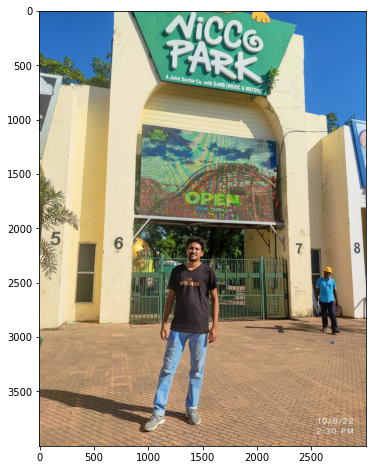

In [ ]:
fig=plt.figure(figsize=(8,8))
plt.imshow(image)

## **Reading an image using openCV \library**

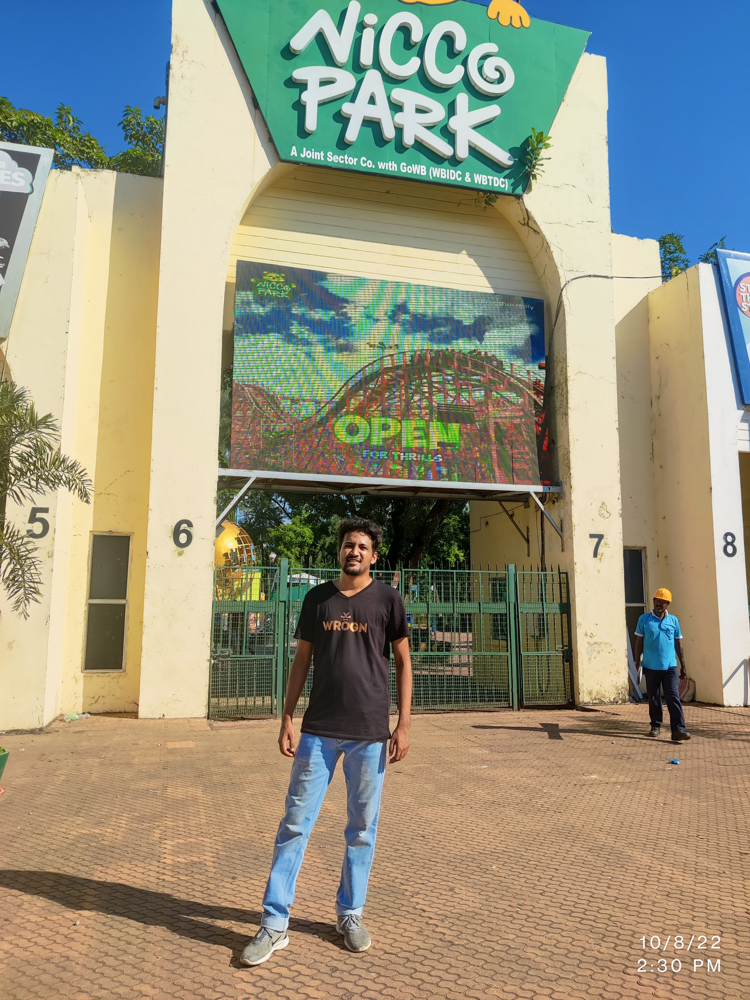

<Figure size 576x576 with 0 Axes>

In [ ]:
from google.colab.patches import cv2_imshow
image=cv2.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg')
fig=plt.figure(figsize=(8,8))
cv2_imshow(image)

## **Reading an image using Matplotlib**

Text(0.5, 1.0, 'Reading image through Matplotlib')

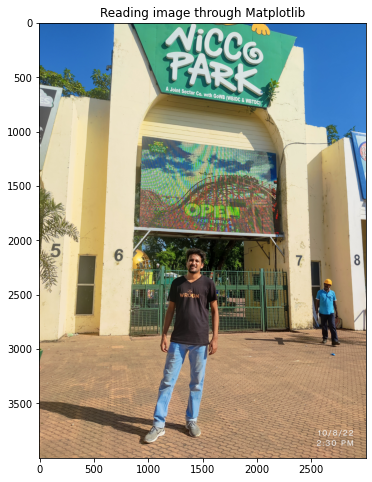

In [ ]:
image=plt.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg')
fig=plt.figure(figsize=(10,8))
plt.imshow(image)
plt.title('Reading image through Matplotlib')

#**1.  Reading Image through skimage**

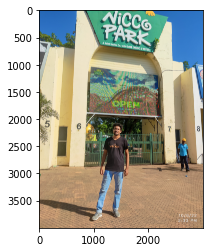

In [ ]:
image=skimage.io.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg')
plt.imshow(image)

## **2.  Reverse contrast using openCV**

Text(0.5, 1.0, 'original gray scale image')

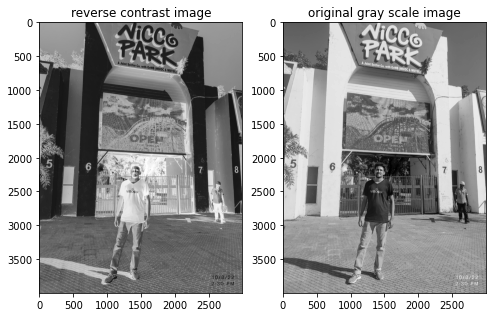

In [ ]:
def reverse_contrast(img):
  image_rev_cont=(255-img)
  return image_rev_cont

# reading image in grayscale
image_gray=cv2.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg',0)

image_reverse_contrast=reverse_contrast(image_gray)
fig=plt.figure(figsize=(8,8))
fig.add_subplot(1,2,1)
plt.imshow(image_reverse_contrast,cmap='gray')
plt.title('reverse contrast image')
fig.add_subplot(1,2,2)
plt.imshow(image_gray,cmap='gray')
plt.title('original gray scale image')


## **2.  streching contrast using Skimage**

Text(0.5, 1.0, 'original gray scale image')

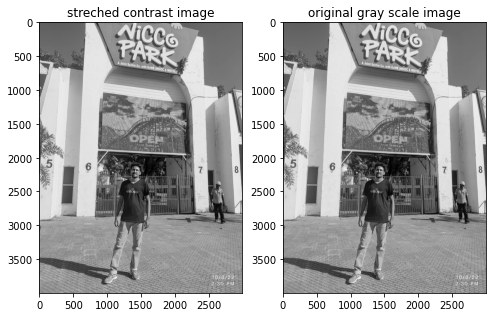

In [ ]:
image=skimage.io.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg',as_gray=True)

def contrast_streching(img):
  image_strech_cont=((img-min(img.flatten()))/(max(img.flatten())-min(img.flatten())))*255
  return image_strech_cont
image_strech_contrast=contrast_streching(image)
fig=plt.figure(figsize=(8,8))
fig.add_subplot(1,2,1)
plt.imshow(image_strech_contrast,cmap='gray')
plt.title('streched contrast image')
fig.add_subplot(1,2,2)
plt.imshow(image,cmap='gray')
plt.title('original gray scale image')

## **2.  Histogram equilization using OpenCV**

Text(0.5, 1.0, 'original image')

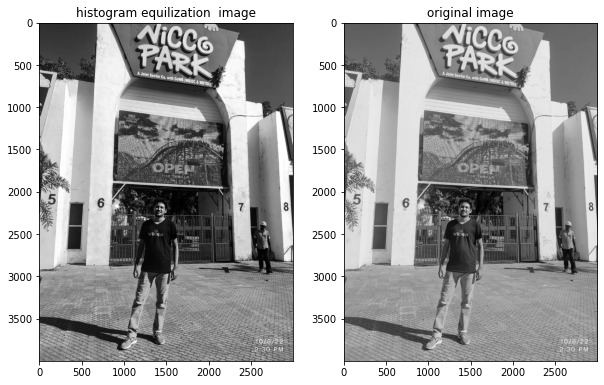

In [ ]:
image_cv=cv2.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg',0)
image_equi= cv2.equalizeHist(image_cv)
fig=plt.figure(figsize=(10,8))
fig.add_subplot(1,2,1)
plt.imshow(image_equi,cmap='gray')

plt.title('histogram equilization  image')
fig.add_subplot(1,2,2)
plt.imshow(image_cv,cmap='gray')
plt.title('original image')


## **2.  Histogram equilization using Skimage**

Text(0.5, 1.0, 'original image')

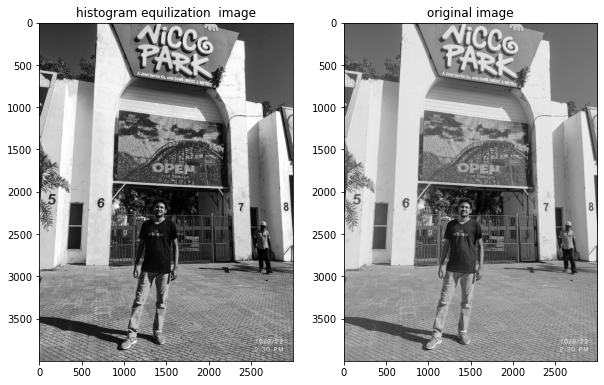

In [ ]:
image=skimage.io.imread('/content/drive/MyDrive/Personal data/Photos/Nico park.jpg',as_gray=True)
# in Skimage the iamges are in 64 bit format so it lies [0,1]
image=skimage.img_as_ubyte(image) # so we need to convert the image into unsigned byte inorder to perform histogram equilization using openCV

image_equi=cv2.equalizeHist(image)
fig=plt.figure(figsize=(10,8))
fig.add_subplot(1,2,1)
plt.imshow(image_equi,cmap='gray')
plt.title('histogram equilization  image')
fig.add_subplot(1,2,2)
plt.imshow(image,cmap='gray')
plt.title('original image')

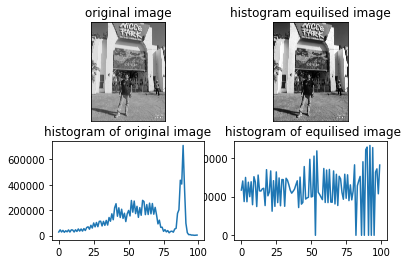

<Figure size 432x288 with 0 Axes>

In [ ]:
import numpy as np

plt.subplot(2, 2, 1)
plt.imshow(image_cv, cmap='gray')
plt.title('original image')
plt.xticks([])
plt.yticks([])

plt.subplot(2, 2, 2)
plt.imshow(image_equi, cmap='gray')
plt.title('histogram equilised image')
plt.xticks([])
plt.yticks([])

plt.subplot(2, 2, 4)
h = np.histogram(image_equi, 100)
plt.plot(h[0])
plt.title(' histogram of equilised image')

plt.subplot(2, 2, 3)
h = np.histogram(image_cv, 100)
plt.plot(h[0])
plt.title('histogram of original image')

plt.show()
plt.tight_layout()

#**3.  WAP to aaply average filtering**


## **Average Filtering using openCV**

Text(0.5, 1.0, 'original image')

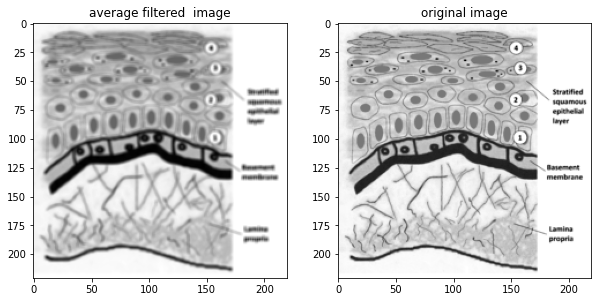

In [ ]:
kernel = np.ones((3,3),np.float32)/9
dst = cv2.filter2D(image_cv,-1,kernel)
fig=plt.figure(figsize=(10,8))
fig.add_subplot(1,2,1)
plt.imshow(dst,cmap='gray')
plt.title('average filtered  image')
fig.add_subplot(1,2,2)
plt.imshow(image_cv,cmap='gray')
plt.title('original image')

# **4. Application of Gaussian filtering**

Text(0.5, 1.0, 'original image')

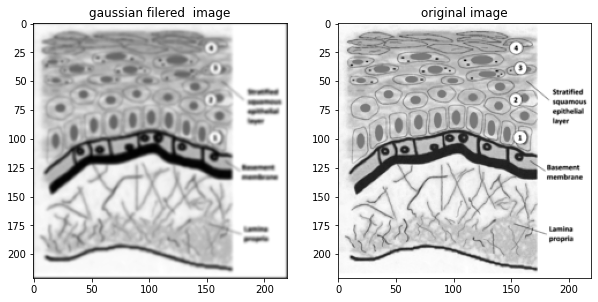

In [ ]:
image_cv=cv2.imread('/content/220px-Oral_mucosa.png',0)
img_gaus=cv2.GaussianBlur(image_cv,(5,5),0,borderType=0)
fig=plt.figure(figsize=(10,8))
fig.add_subplot(1,2,1)
plt.imshow(img_gaus,cmap='gray')
plt.title('gaussian filered  image')
fig.add_subplot(1,2,2)
plt.imshow(image_cv,cmap='gray')
plt.title('original image')

# **5. WAP to extract vertcal and Horizontal Lines of one image**

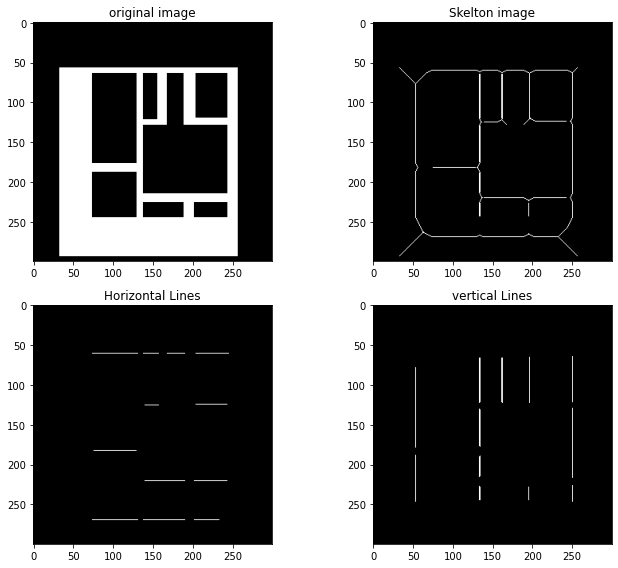

In [ ]:
def skeletonize(img):  
  ''' this function is used to skeletonize the image 
  as openCV doesnt come up with built in function for skeletonization
  skeletonization is important to reduce th effect of width of the instances
  if some instance's width or height is unequal with others then we would face
  the problem of generalising the threshold 
  '''
  size = np.size(img)
  skel = np.zeros(img.shape,np.uint8) # creating an empty array of same size of the original array 

  ret,img = cv2.threshold(img,127,255,0) # just keeping the threshold as (127 = 255+1/2)
  element = cv2.getStructuringElement(cv2.MORPH_CROSS,(3,3))
  done = False

  while( not done):
      eroded = cv2.erode(img,element)
      temp = cv2.dilate(eroded,element)
      temp = cv2.subtract(img,temp)
      skel = cv2.bitwise_or(skel,temp)
      img = eroded.copy()

      zeros = size - cv2.countNonZero(img)
      if zeros==size:
          done = True
  return skel

image = cv2.imread('/content/binary.png' , 0)
fi=plt.figure(figsize=(10,8))
plt.subplot(2,2,1)
plt.imshow(image,cmap='gray')
plt.title('original image')
thresh = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

thresh = skeletonize(thresh)
plt.subplot(2,2,2)
plt.imshow(thresh,cmap='gray')
plt.title("Skelton image")
cv2.waitKey()

horizontal_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (10, 1))
horizontal = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, horizontal_kernel, 
iterations=1)

plt.subplot(2,2,3)
plt.imshow( horizontal,cmap='gray')
plt.title("Horizontal Lines" )
cv2.waitKey()

vertical_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (1, 10))
vertical = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, vertical_kernel, 
iterations=1)

plt.subplot(2,2,4)
plt.imshow( vertical,cmap='gray')
plt.title("vertical Lines" )
cv2.waitKey()
plt.tight_layout()